# Diabetes 130 Vignette

This tutorial explores the Diabetes 130-US hospitals for years 1999-2008 dataset. This data has been prepared to analyze factors related to readmission as well as other outcomes pertaining to patients with diabetes. We use ehrapy's slightly preprocessed dataset (https://github.com/theislab/ehrapy-datasets/tree/main/diabetes_130).

More details on the dataset can be found here: http://archive.ics.uci.edu/ml/datasets/Diabetes+130-US+hospitals+for+years+1999-2008.

It is recommended to work through the MIMIC-II tutorials first before examining this one.

## Importing ehrapy and setting plotting parameters

In [1]:
import ehrapy as ep
import seaborn as sns
import matplotlib.pyplot as plt

Installed version 0.2.0 of ehrapy is newer than the latest release 0.1.0! You are running a 
nightly version and features may break!

In [2]:
import warnings

warnings.simplefilter("ignore", category=UserWarning)
warnings.simplefilter("ignore", category=FutureWarning)
warnings.simplefilter("ignore", category=DeprecationWarning)

In [3]:
ep.print_versions()

The `sinfo` package has changed name and is now called `session_info` to become more 
discoverable and self-explanatory. The `sinfo` PyPI package will be kept around to avoid 
breaking old installs and you can downgrade to 0.3.2 if you want to use it without seeing 
this message. For the latest features and bug fixes, please install `session_info` instead. 
The usage and defaults also changed slightly, so please review the latest README at 
https://gitlab.com/joelostblom/session_info.
-----
ehrapy      0.2.0
rich        NA
scanpy      1.8.2
sinfo       0.3.4
-----
PIL                         9.0.1
PyPDF2                      1.26.0
anndata                     0.7.8
anyio                       NA
attr                        21.4.0
babel                       2.9.1
backcall                    0.2.0
bs4                         4.10.0
camelot                     0.10.1
category_encoders           2.3.0
certifi                     2021.10.08
cffi                        1.15.0
chardet                     4.0.0
charset_normalizer          2.0.11
colorama                    0.4.4
cryptography                36.0.1
cv2                         4.5.5
cycler                      0.10.0
cython_runtime              NA
dateutil                    2.8.2
debugpy                     1.5.1
decorator                   5.1.1
deep_translator             1.6.1
deepl                       1.4.1
defusedxml                  0.7.1
entrypoints                 0.4
h5py                        3.6.0
html5lib                    1.1
idna                        3.3
igraph                      0.9.9
importlib_resources         NA
ipykernel                   6.5.0
ipython_genutils            0.2.0
ipywidgets                  7.6.5
jedi                        0.18.1
jinja2                      3.0.3
joblib                      1.1.0
json5                       NA
jsonschema                  4.4.0
jupyter_server              1.11.2
jupyterlab_server           2.8.2
kiwisolver                  1.3.2
leidenalg                   0.8.8
llvmlite                    0.34.0
markupsafe                  2.0.1
matplotlib                  3.5.1
matplotlib_inline           NA
mpl_toolkits                NA
mudata                      0.1.1
natsort                     8.1.0
nbclassic                   NA
nbformat                    5.1.3
numba                       0.51.2
numexpr                     2.8.1
numpy                       1.20.3
packaging                   21.3
pandas                      1.3.4
parso                       0.8.3
patsy                       0.5.2
pdfminer                    20211012
pexpect                     4.8.0
pickleshare                 0.7.5
pkg_resources               NA
prometheus_client           NA
prompt_toolkit              3.0.26
psutil                      5.9.0
ptyprocess                  0.7.0
pvectorc                    NA
pyarrow                     7.0.0
pydev_ipython               NA
pydevconsole                NA
pydevd                      2.6.0
pydevd_concurrency_analyser NA
pydevd_file_utils           NA
pydevd_plugins              NA
pydevd_tracing              NA
pygments                    2.11.2
pyparsing                   3.0.7
pypi_latest                 0.1.2
pyrsistent                  NA
pytz                        2021.3
questionary                 1.10.0
requests                    2.27.1
ruamel                      NA
scipy                       1.6.1
seaborn                     0.11.2
send2trash                  NA
setuptools_scm              NA
six                         1.16.0
sklearn                     1.0.2
sniffio                     1.2.0
soupsieve                   2.3.1
sphinxcontrib               NA
statsmodels                 0.13.1
storemagic                  NA
tables                      3.7.0
terminado                   0.12.1
texttable                   1.6.4
threadpoolctl               3.1.0
tornado                     6.1
traitlets                   5.1.1
typing_extensions           NA
urllib3  

In [4]:
ep.settings.set_figure_params(figsize=(4, 4))

## Diabetes 130 dataset preprocessing

There are a couple of columns which have a high amount of missing data or are not informative to the model. We will move them to obs only.

In [5]:
adata = ep.dt.diabetes_130(encoded=False, columns_obs_only=["age",
                                                            "age_mean",
                                                            "weight_mean",
                                                            "weight",
                                                            "patient_nbr",
                                                            "payer_code"
                                                            ])

/home/zeth/PycharmProjects/ehrapy/ehrapy/io/_read.py:166: DtypeWarning: Columns (10) have mixed types.Specify dtype option on import or set low_memory=False.
  raw_anndata, columns_obs_only = read_csv(


In [6]:
ep.pp.type_overview(adata)

Variable names for AnnData object with 45 vars and 101766 obs                                
╚══ 🔓 Unencoded variables                                                                   
    ╠══ race -> data type: string                                                            
    ╠══ gender -> data type: floating                                                        
    ╠══ admission_type_id -> data type: string                                               
    ╠══ discharge_disposition_id -> data type: string                                        
    ╠══ admission_source_id -> data type: string                                             
    ╠══ time_in_hospital_days -> data type: integer                                          
    ╠══ medical_specialty -> data type: string                                               
    ╠══ num_lab_procedures -> data type: integer                                             
    ╠══ num_procedures -> data type: integer                                                 
    ╠══ num_medications -> data type: integer                                                
    ╠══ number_outpatient_visits -> data type: integer                                       
    ╠══ number_emergency_visits -> data type: integer                                        
    ╠══ number_inpatient_visits -> data type: integer                                        
    ╠══ diag_1 -> data type: string                                                          
    ╠══ diag_2 -> data type: string                                                          
    ╠══ diag_3 -> data type: string                                                          
    ╠══ number_diagnoses -> data type: integer                                               
    ╠══ max_glu_serum -> data type: string                                                   
    ╠══ A1Cresult -> data type: string                                                       
    ╠══ metformin -> data type: string                                                       
    ╠══ repaglinide -> data type: string                                                     
    ╠══ nateglinide -> data type: string                                                     
    ╠══ chlorpropamide -> data type: string                                                  
    ╠══ glimepiride -> data type: string                                                     
    ╠══ acetohexamide -> data type: string                                                   
    ╠══ glipizide -> data type: string                                                       
    ╠══ glyburide -> data type: string                                                       
    ╠══ tolbutamide -> data type: string                                                     
    ╠══ pioglitazone -> data type: string                                                    
    ╠══ rosiglitazone -> data type: string                                                   
    ╠══ acarbose -> data type: string                                                        
    ╠══ miglitol -> data type: string                                                        
    ╠══ troglitazone -> data type: string                                                    
    ╠══ tolazamide -> data type: string                                                      
    ╠══ examide -> data type: string                                                         
    ╠══ citoglipton -> data type: string                                                     
    ╠══ insulin -> data type: string                                                         
    ╠══ glyburide-metformin -> data type: string                                             
    ╠══ glipizide-metformin -> data type: string                                             
    ╠══ glimepiride-pioglitazone -> data type: string                                        
    ╠══ metformin-rosiglitazone -> data type: string 

In [7]:
adata=ep.pp.encode(adata,autodetect=True)

Output()

In [8]:
_ = ep.pp.calculate_qc_metrics(adata)

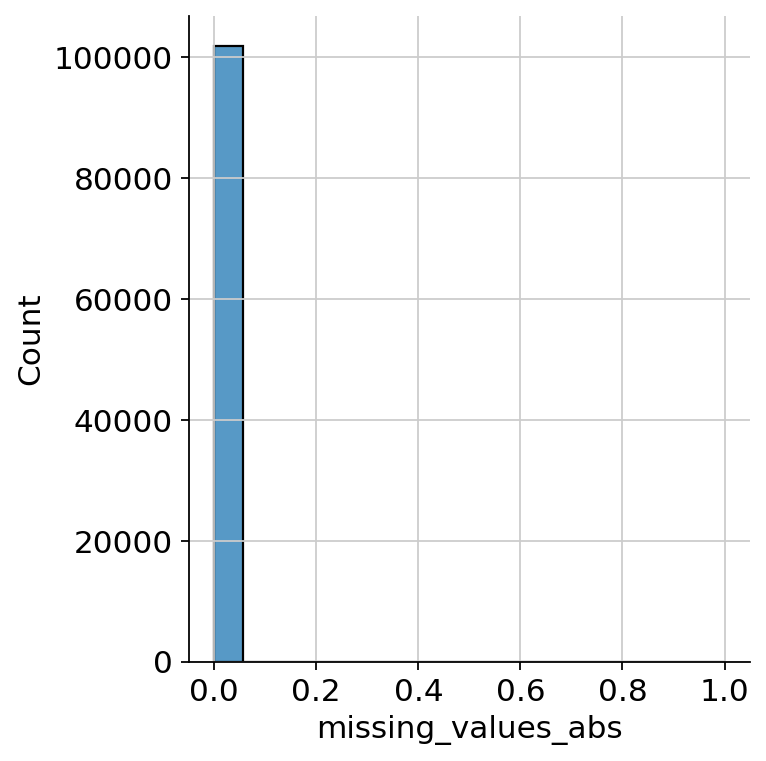

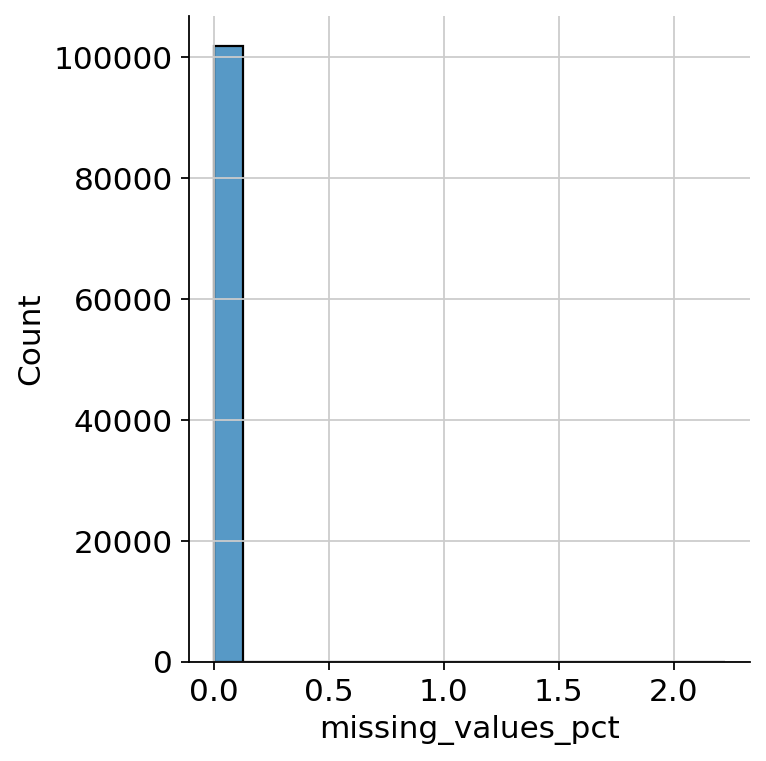

In [9]:
_ = sns.displot(adata.obs["missing_values_abs"])
plt.show()

_ = sns.displot(adata.obs["missing_values_pct"])

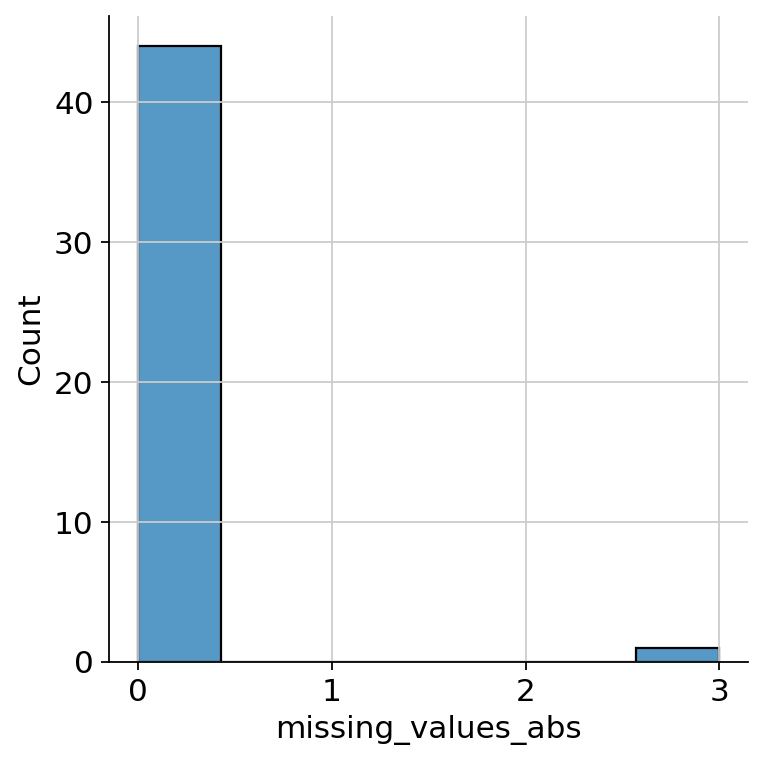

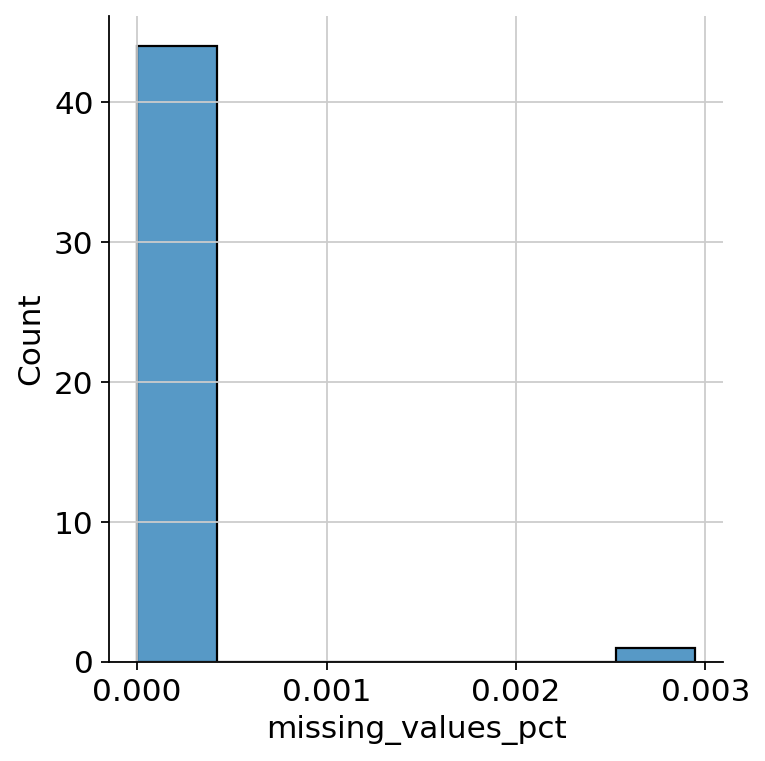

In [10]:
_ = sns.displot(adata.var["missing_values_abs"])
plt.show()

_ = sns.displot(adata.var["missing_values_pct"])

In [11]:
ep.pp.knn_impute(adata)

Output()

AnnData object with n_obs × n_vars = 101766 × 45
    obs: 'age', 'age_mean', 'weight_mean', 'weight', 'patient_nbr', 'payer_code', 'race', 'admission_type_id', 'discharge_disposition_id', 'admission_source_id', 'medical_specialty', 'diag_1', 'diag_2', 'diag_3', 'max_glu_serum', 'A1Cresult', 'metformin', 'repaglinide', 'nateglinide', 'chlorpropamide', 'glimepiride', 'acetohexamide', 'glipizide', 'glyburide', 'tolbutamide', 'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 'troglitazone', 'tolazamide', 'examide', 'citoglipton', 'insulin', 'glyburide-metformin', 'glipizide-metformin', 'glimepiride-pioglitazone', 'metformin-rosiglitazone', 'metformin-pioglitazone', 'change_of_meds', 'diabetesMed', 'readmitted', 'missing_values_abs', 'missing_values_pct'
    var: 'missing_values_abs', 'missing_values_pct', 'mean', 'median', 'standard_deviation', 'min', 'max'
    uns: 'numerical_columns', 'non_numerical_columns', 'original_values_categoricals', 'var_to_encoding', 'encoding_to_var'
   

# Visual Exploration

In [12]:
ep.pp.pca(adata)

In [13]:
ep.pp.neighbors(adata)

In [14]:
ep.tl.umap(adata)

... storing 'age' as categorical
... storing 'weight' as categorical
... storing 'payer_code' as categorical
... storing 'race' as categorical
... storing 'admission_type_id' as categorical
... storing 'discharge_disposition_id' as categorical
... storing 'admission_source_id' as categorical
... storing 'medical_specialty' as categorical
... storing 'diag_1' as categorical
... storing 'diag_2' as categorical
... storing 'diag_3' as categorical
... storing 'max_glu_serum' as categorical
... storing 'A1Cresult' as categorical
... storing 'metformin' as categorical
... storing 'repaglinide' as categorical
... storing 'nateglinide' as categorical
... storing 'chlorpropamide' as categorical
... storing 'glimepiride' as categorical
... storing 'acetohexamide' as categorical
... storing 'glipizide' as categorical
... storing 'glyburide' as categorical
... storing 'tolbutamide' as categorical
... storing 'pioglitazone' as categorical
... storing 'rosiglitazone' as categorical
... storing 'acar

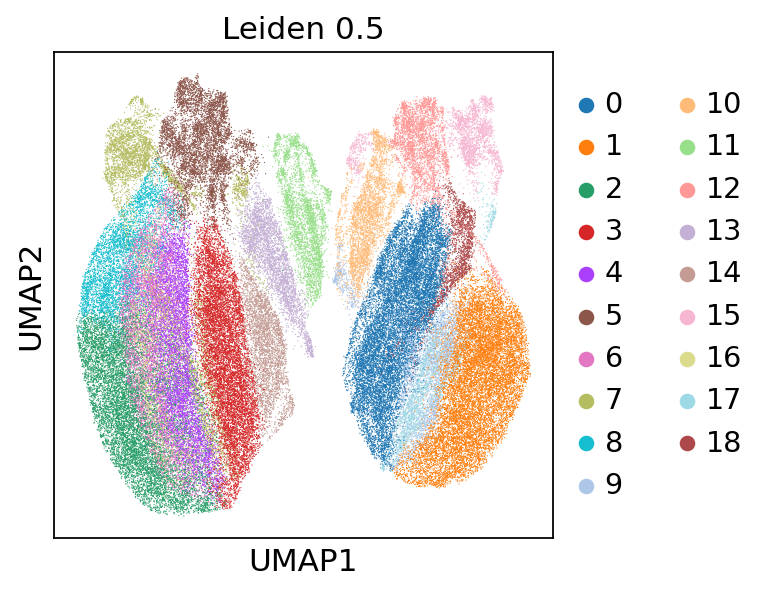

In [15]:
ep.tl.leiden(adata, resolution=0.5, key_added="leiden_0_5")
ep.pl.umap(adata, color=["leiden_0_5"], title="Leiden 0.5")

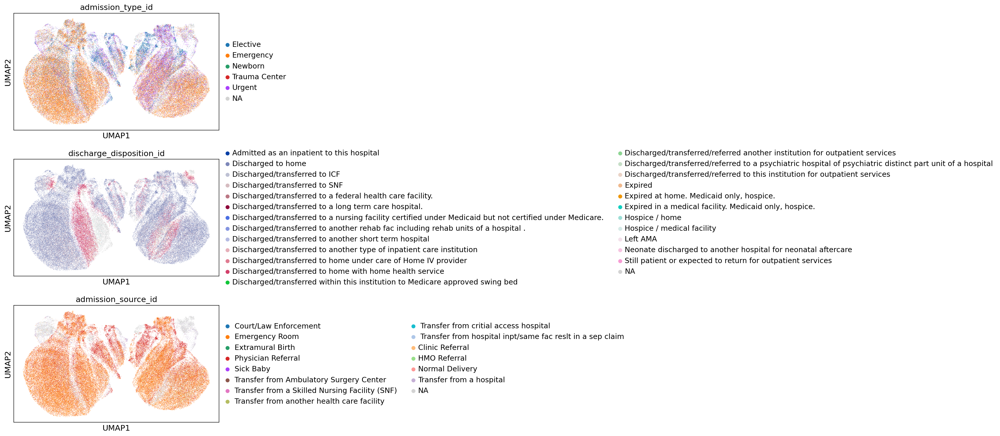

In [16]:
ep.pl.umap(adata, color=["admission_type_id", "discharge_disposition_id", "admission_source_id",], ncols=1, wspace=0.75)

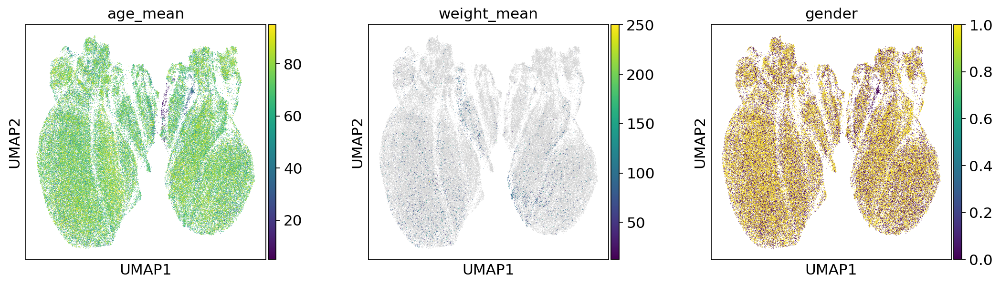

In [17]:
ep.pl.umap(adata, color=["age_mean", "weight_mean", "gender"], wspace=0.3)

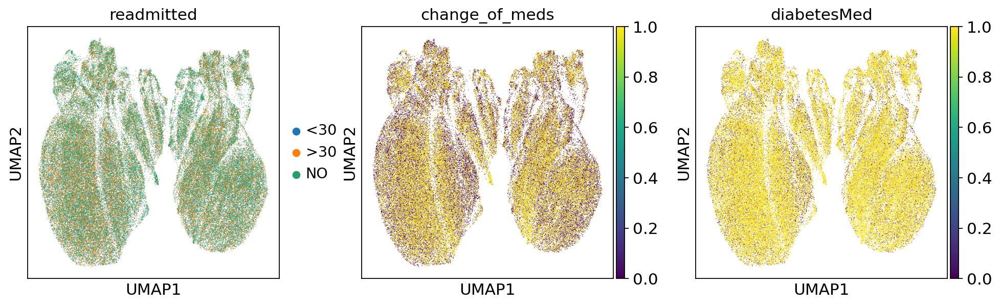

In [18]:
ep.pl.umap(adata, color=["readmitted", "change_of_meds", "diabetesMed"])

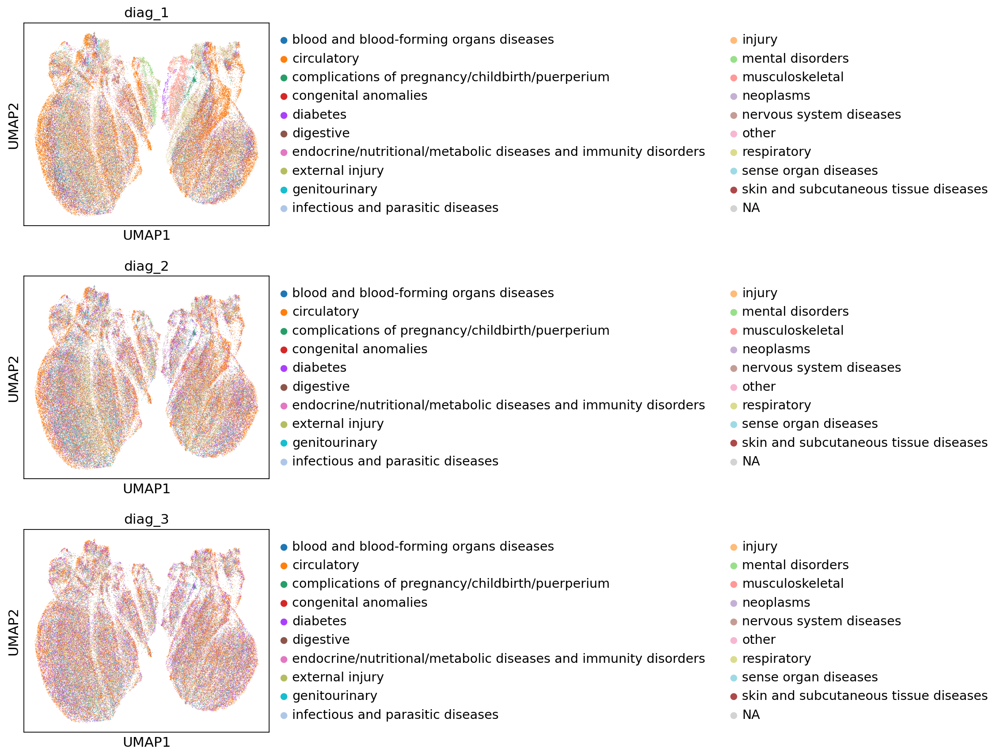

In [19]:
ep.pl.umap(adata, color=["diag_1", "diag_2", "diag_3"], ncols=1)

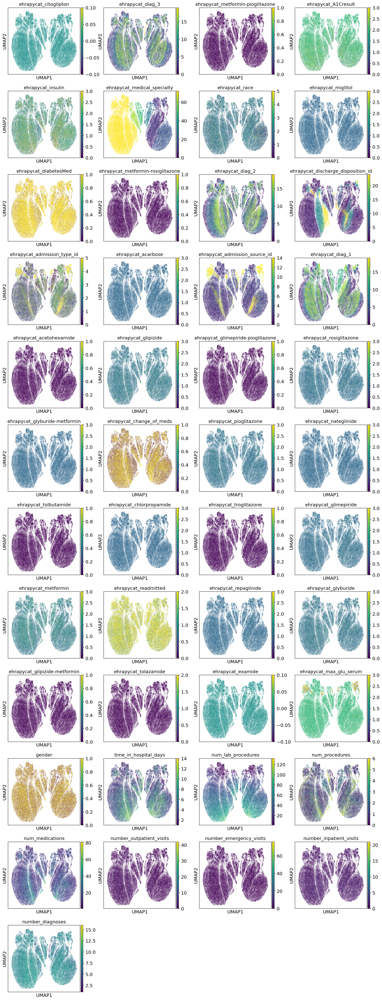

In [20]:
ep.pl.umap(adata, color=list(adata.var_names))